In [1]:
# Module Importations
import matplotlib.pylab as plt
import numpy as np
import pandas as pd
import sklearn
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import cross_val_score
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import PolynomialFeatures
from yellowbrick.regressor import PredictionError, ResidualsPlot

# Print versioning information
print('numpy version =', np.__version__)  
print('pandas version =', pd.__version__)
print('sklearn version =', sklearn.__version__)

numpy version = 1.19.4
pandas version = 1.1.4
sklearn version = 0.22.2.post1


In [2]:
# Custom Module Imports
from Source.data import load_data
from Source.data import split_data
from Source.models import model_evaluation
from Source.models import sklearn_helpers

C:\Developer\Python\Python366\lib\site-packages\sklearn\externals\joblib\__init__.py:15: FutureWarning: sklearn.externals.joblib is deprecated in 0.21 and will be removed in 0.23. Please import this functionality directly from joblib, which can be installed with: pip install joblib. If this warning is raised when loading pickled models, you may need to re-serialize those models with scikit-learn 0.21+.
  warnings.warn(msg, category=FutureWarning)


In [3]:
# Load data from pickle
df_plant1 = load_data.load_pickled_data("df_plant1_feat_eng.pkl")
df_plant2 = load_data.load_pickled_data("df_plant2_feat_eng.pkl")

Loading pickled dataframe started ...
Loading pickled dataframe complete ...
Loading pickled dataframe started ...
Loading pickled dataframe complete ...


In [4]:
df_plant1.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 71808 entries, 0 to 71806
Data columns (total 20 columns):
 #   Column           Non-Null Count  Dtype         
---  ------           --------------  -----         
 0   DATE_TIME        71808 non-null  datetime64[ns]
 1   PLANT_ID         71808 non-null  object        
 2   SOURCE_KEY       71808 non-null  object        
 3   DC_POWER         71808 non-null  float64       
 4   DAILY_YIELD      71808 non-null  float64       
 5   AMB_TEMP         71808 non-null  float64       
 6   MOD_TEMP         71808 non-null  float64       
 7   IRRADIATION      71808 non-null  float64       
 8   DATE             71808 non-null  object        
 9   TIME_OF_DAY      71808 non-null  object        
 10  HOUR             71808 non-null  int64         
 11  DAY              71808 non-null  int64         
 12  WEEKDAY          71808 non-null  object        
 13  MONTH            71808 non-null  int64         
 14  YEAR             71808 non-null  int64

In [5]:
# Data Munging - Convert time of day to float
def convert_time_to_float(time):
    return time.hour / 24.0 + time.minute / (24.0*60.0) + time.second / (24.0*60.0*60.0) + time.microsecond / (24.0*60.0*60.0*1000000.0)

for df in [df_plant1, df_plant2]:
    df['TIME_FLOAT'] = df.apply(lambda row: convert_time_to_float(row['DATE_TIME']), axis = 1)

In [6]:
# Drop unrequired data columns

# Identify columns to drop
cols_to_keep = ['DC_POWER', 'AMB_TEMP', 'MOD_TEMP', 'IRRADIATION', 'TIME_FLOAT']
cols_to_drop = []

for col in df_plant1.columns:
    if col not in cols_to_keep:
        cols_to_drop.append(col)

for df in [df_plant1, df_plant2]:
    df.drop(cols_to_drop, axis = 1, inplace = True)

df_plant2.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 71808 entries, 0 to 71807
Data columns (total 5 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   DC_POWER     71808 non-null  float64
 1   AMB_TEMP     71808 non-null  float64
 2   MOD_TEMP     71808 non-null  float64
 3   IRRADIATION  71808 non-null  float64
 4   TIME_FLOAT   71808 non-null  float64
dtypes: float64(5)
memory usage: 3.3 MB


In [7]:
# Split data into training / evaluation sets
training_set_plant1, evaluation_set_plant1 = split_data.split_train_eval(df_plant1, 0.2)
training_set_plant2, evaluation_set_plant2 = split_data.split_train_eval(df_plant2, 0.2)

Original Data Items: 71808
Training Data Items: 57447
Evaluation Data Items: 14361
Original Data Items: 71808
Training Data Items: 57447
Evaluation Data Items: 14361


In [8]:
# Create DC Power Target datasets

# Modify training sets
dc_power_training_data_pt1 = training_set_plant1.drop('DC_POWER', axis = 1)
dc_label_data_pt1 = training_set_plant1['DC_POWER'].copy()

dc_power_training_data_pt2 = training_set_plant2.drop('DC_POWER', axis = 1)
dc_label_data_pt2 = training_set_plant2['DC_POWER'].copy()

# Modify evaluation sets
dc_evaluation_data_pt1 = evaluation_set_plant1.drop('DC_POWER', axis = 1)
dc_eval_label_data_pt1 = evaluation_set_plant1['DC_POWER'].copy()

dc_evaluation_data_pt2 = evaluation_set_plant2.drop('DC_POWER', axis = 1)
dc_eval_label_data_pt2 = evaluation_set_plant2['DC_POWER'].copy()

In [9]:
# Check shape of arrays
print('Plant 1:')
print('Fit Train:', dc_power_training_data_pt1.shape)
print('Fit Label:', dc_label_data_pt1.shape)
print('Eval Train:', dc_evaluation_data_pt1.shape)
print('Eval Label:', dc_eval_label_data_pt1.shape)

print('Plant 2:')
print('Fit Train:', dc_power_training_data_pt2.shape)
print('Fit Label:', dc_label_data_pt2.shape)
print('Eval Train:', dc_evaluation_data_pt2.shape)
print('Eval Label:', dc_eval_label_data_pt2.shape)

Plant 1:
Fit Train: (57447, 4)
Fit Label: (57447,)
Eval Train: (14361, 4)
Eval Label: (14361,)
Plant 2:
Fit Train: (57447, 4)
Fit Label: (57447,)
Eval Train: (14361, 4)
Eval Label: (14361,)


In [10]:
# Normalise Inputs
normalise_inputs = False
normalise_outputs = False

normaliser = MinMaxScaler()

if normalise_inputs == True:

    # Transform training sets
    dc_power_training_data_pt1 = normaliser.fit_transform(dc_power_training_data_pt1)
    dc_power_training_data_pt2 = normaliser.fit_transform(dc_power_training_data_pt2)

    # Transform evaluation sets
    dc_evaluation_data_pt1 = normaliser.fit_transform(dc_evaluation_data_pt1)
    dc_evaluation_data_pt2 = normaliser.fit_transform(dc_evaluation_data_pt2)

if normalise_outputs == True:

    # Transform training sets
    dc_label_data_pt1 = normaliser.fit_transform(dc_label_data_pt1)
    dc_label_data_pt2 = normaliser.fit_transform(dc_label_data_pt2)

    # Transform evaluation sets
    dc_eval_label_data_pt1 = normaliser.fit_transform(dc_eval_label_data_pt1)
    dc_eval_label_data_pt2 = normaliser.fit_transform(dc_eval_label_data_pt2)

In [11]:
# Linear Regression Model (Target - DC Power, Plant 1)
lin_reg_dc = LinearRegression()
model_name = "LinReg_DC_Plant1"

# Train model
lin_reg_dc.fit(dc_power_training_data_pt1, dc_label_data_pt1)

# Save model
model_name = sklearn_helpers.name_model(model_name)
sklearn_helpers.save_model(lin_reg_dc, model_name)

# Compute RMSE via cross validation
scores_mse = cross_val_score(lin_reg_dc, dc_power_training_data_pt1, dc_label_data_pt1, scoring = "neg_mean_squared_error", cv = 5)
scores_rmse = np.sqrt(-scores_mse)

# Compute MAE via cross validation
scores_mae = cross_val_score(lin_reg_dc, dc_power_training_data_pt1, dc_label_data_pt1, scoring = "neg_mean_absolute_error", cv = 5)
scores_mae = -1 * scores_mae

# Visualise cross validation results
print(model_name, "rmse mean (cv):", scores_rmse.mean())
print(model_name, "rmse std (cv):", scores_rmse.std())
print(model_name, "mae mean (cv):", scores_mae.mean())
print(model_name, "mae std (cv):", scores_mae.std())

Save Path: C:\Developer\solar-power-generation-project\Models\WJ_LinReg_DC_Plant1_2021_05_20-12_25_34.pkl
WJ_LinReg_DC_Plant1_2021_05_20-12_25_34.pkl rmse mean (cv): 59.41481435494886
WJ_LinReg_DC_Plant1_2021_05_20-12_25_34.pkl rmse std (cv): 1.8421979008931448
WJ_LinReg_DC_Plant1_2021_05_20-12_25_34.pkl mae mean (cv): 26.356657817704804
WJ_LinReg_DC_Plant1_2021_05_20-12_25_34.pkl mae std (cv): 0.3266460567230457


In [12]:
# Model Evaluation - Linear Regr (Target - DC Power, Plant 1)

# Describe model coefficients
print("Amb Temp Coef: ", lin_reg_dc.coef_[0])
print("Mod Temp Coef: ", lin_reg_dc.coef_[1])
print("Irradiation Coef: ", lin_reg_dc.coef_[2])
print("Time Coef: ", lin_reg_dc.coef_[3])

# Evaluate model
dc_power_pred_eval = lin_reg_dc.predict(dc_evaluation_data_pt1)
model_evaluation.evaluate_model(model_name, dc_eval_label_data_pt1, dc_power_pred_eval)

Amb Temp Coef:  -0.3552891692022955
Mod Temp Coef:  1.9671706584049673
Irradiation Coef:  1249.9518530022922
Time Coef:  2.592771852036336
WJ_LinReg_DC_Plant1_2021_05_20-12_25_34.pkl rmse (Eval): 57.70978208676702
WJ_LinReg_DC_Plant1_2021_05_20-12_25_34.pkl mae (Eval): 26.008489485064537
WJ_LinReg_DC_Plant1_2021_05_20-12_25_34.pkl r2 (Eval): 0.9791050528488625


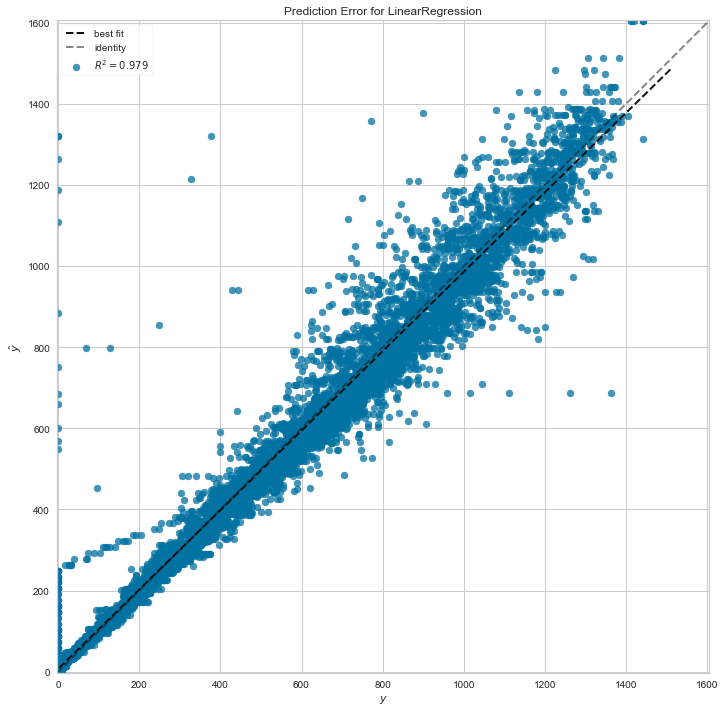

In [13]:
# Visualise Prediction Error - Lin Reg (Target - DC Power, Plant 1)
fig, ax = plt.subplots(figsize = (14,12))

# Initialise visualiser
visualiser_error = PredictionError(lin_reg_dc, ax = ax)

# Fit visualiser
visualiser_error.fit(dc_power_training_data_pt1, dc_label_data_pt1)
visualiser_error.score(dc_evaluation_data_pt1, dc_eval_label_data_pt1)
visualiser_error.poof()

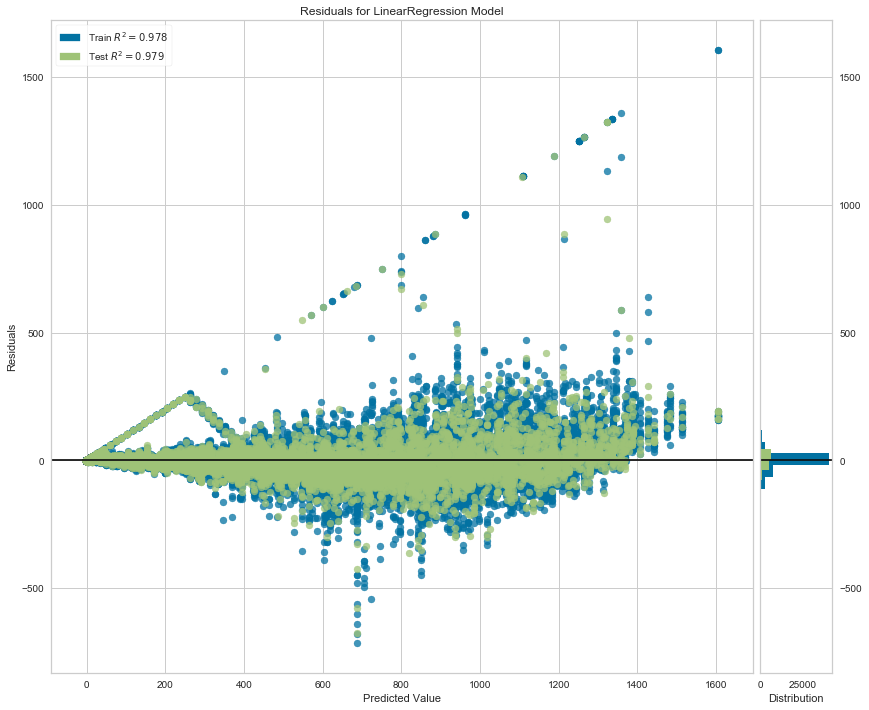

In [14]:
# Visualise Residuals - Lin Reg (Target - DC Power, Plant 1)
fig, ax = plt.subplots(figsize = (14,12))

# Initialise visualiser
visualiser_residual = ResidualsPlot(lin_reg_dc, ax = ax)

# Fit visualiser
visualiser_residual.fit(dc_power_training_data_pt1, dc_label_data_pt1)
visualiser_residual.score(dc_evaluation_data_pt1, dc_eval_label_data_pt1)
visualiser_residual.poof()

In [ ]:
# Linear Regression Model (Target - DC Power, Plant 1)

In [ ]:
# Model Evaluation - Linear Regr (Target - DC Power, Plant 1)

In [ ]:
# Visualise Prediction Error - Lin Reg (Target - DC Power, Plant 1)

In [ ]:
# Visualise Residuals - Lin Reg (Target - DC Power, Plant 1)

In [15]:
# Polynomial Regression (Target - DC Power)
lin_reg_poly_dc = LinearRegression()

# Create Polynomial Dataset
poly_features = PolynomialFeatures(degree = 2, include_bias = False)
dc_training_poly = poly_features.fit_transform(dc_power_training_data)

# Train Model
lin_reg_poly_dc.fit(dc_training_poly, dc_label_data)

model_name = "LinRegPoly_DC"

# Save model
model_name = sklearn_helpers.name_model(model_name)
sklearn_helpers.save_model(lin_reg_poly_dc, model_name)

# Compute RMSE via cross validation
scores_mse = cross_val_score(lin_reg_poly_dc, dc_training_poly, dc_label_data, scoring = "neg_mean_squared_error", cv = 5)
scores_rmse = np.sqrt(-scores_mse)

# Compute MAE via cross validation
scores_mae = cross_val_score(lin_reg_poly_dc, dc_training_poly, dc_label_data, scoring = "neg_mean_absolute_error", cv = 5)
scores_mae = -1 * scores_mae

# Visualise cross validation results
print(model_name, "rmse mean (cv):", scores_rmse.mean())
print(model_name, "rmse std (cv):", scores_rmse.std())
print(model_name, "% Acc:", ((1-(scores_rmse.mean()/DC_Power_Range))*100))

print(model_name, "mae mean (cv):", scores_mae.mean())
print(model_name, "mae (cv):", scores_mae.std())

NameError: name 'dc_power_training_data' is not defined

In [15]:
# Polynomial Regression - Model Evaluation (Target - DC Power)

# Describe model coefficients
print(lin_reg_poly_dc.coef_)

# Evaluate model (includes poly conversion of input data)
dc_eval_poly = poly_features.fit_transform(dc_evaluation_data)
dc_power_pred_eval = lin_reg_poly_dc.predict(dc_eval_poly)
model_evaluation.evaluate_model(model_name, dc_eval_label_data, dc_power_pred_eval)

[-1.70200321e+00  9.05123071e+03  8.28311591e+02 -2.01390393e+02
  2.03162007e+04 -1.73059965e+02 -9.54497658e-02  2.74757124e+00
  3.30993032e-01 -1.80754253e-01  7.61630781e+00 -9.53282158e-01
 -3.16995305e+03  1.03437939e+02 -4.39033826e+02  2.00541032e+04
  9.85043058e+02 -1.78352445e+01  8.05052310e+00 -2.62149468e+02
 -7.17846101e+01  2.90147144e-02  1.59026900e+01  1.39571163e+02
 -5.51626261e+03 -5.34751678e+03 -5.19179894e+02]
WJ_LinRegPoly_DC_2020_12_30-14_30_26.pkl rmse (Eval): 1173.1783999940685
WJ_LinRegPoly_DC_2020_12_30-14_30_26.pkl mae (Eval): 642.3607270320235
WJ_LinRegPoly_DC_2020_12_30-14_30_26.pkl r2 (Eval): 0.915656379067132


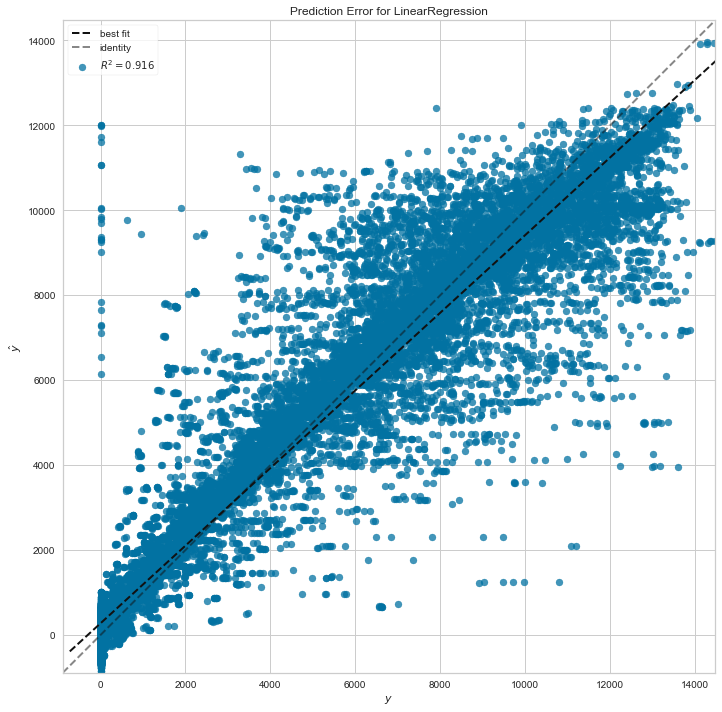

In [16]:
# Visualise Prediction Error - Lin Reg Poly (Target - DC Power)
fig, ax = plt.subplots(figsize = (14,12))

# Initialise visualiser
visualiser_error = PredictionError(lin_reg_poly_dc, ax = ax)

# Fit visualiser
visualiser_error.fit(dc_training_poly, dc_label_data)
visualiser_error.score(dc_eval_poly, dc_eval_label_data)
visualiser_error.poof()

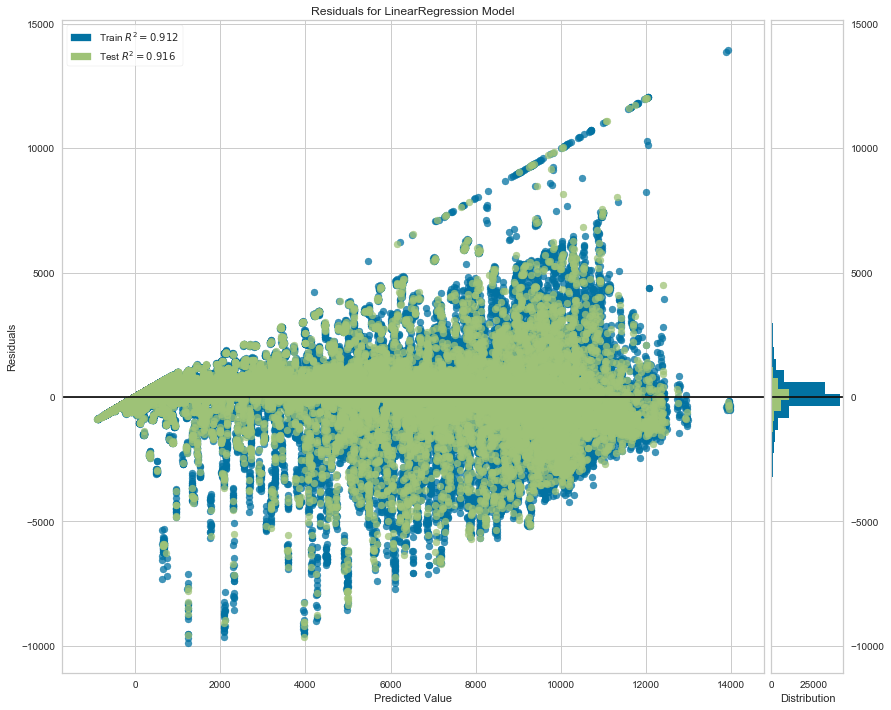

In [17]:
# Visualise Residuals - Lin Reg Poly (Target - DC Power)
fig, ax = plt.subplots(figsize = (14,12))

# Initialise visualiser
visualiser_residual = ResidualsPlot(lin_reg_poly_dc, ax = ax)

# Fit visualiser
visualiser_residual.fit(dc_training_poly, dc_label_data)
visualiser_residual.score(dc_eval_poly, dc_eval_label_data)
visualiser_residual.poof()